<a href="https://colab.research.google.com/github/becker88/ColabCode/blob/main/xarray_basics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
if 'google.colab' in str(get_ipython()):
    !pip install odc-stac
    !pip install pystac_client odc-stac rioxarray
    !pip install distributed

In [ ]:
import os
import matplotlib.pyplot as plt
from pystac_client import Client
from odc.stac import stac_load
import pystac_client
import xarray as xr
import rioxarray as rxr

In [ ]:
data_folder = 'data'
output_folder = 'output'

if not os.path.exists(data_folder):
    os.mkdir(data_folder)
if not os.path.exists(output_folder):
    os.mkdir(output_folder)

In [ ]:
latitude = 27.163
longitude = 82.608
year = 2023

In [ ]:
catelog = pystac_client.Client.open(
    'https://earth-search.aws.element84.com/v1')

# Define a small bounding box around the chosen point
km2deg = 1.0/111
x,y = (longitude, latitude)
r = 1 * km2deg #radious in degree
bbox = (x - r, y - r, x + r, y + r)

search = catelog.search(
    collections=['sentinel-2-c1-l2a'],
    bbox=bbox,
    datetime=f'{year}',
    query={'eo:cloud_cover': {'lt':30}},
)
items = search.item_collection()

In [ ]:
ds = stac_load(
    items,
    bands=['red','green','blue','nir'],
    resolution=10,
    bbox=bbox,
    chunks={}, #<--use Dask
    groupby='solar_day'
)
ds

<xarray.Dataset> Size: 21MB
Dimensions:      (y: 202, x: 182, time: 70)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
Data variables:
    red          (time, y, x) uint16 5MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    green        (time, y, x) uint16 5MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    blue         (time, y, x) uint16 5MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    nir          (time, y, x) uint16 5MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>

In [ ]:
%%time
ds.compute()

CPU times: user 8.12 s, sys: 846 ms, total: 8.97 s
Wall time: 1min


<xarray.Dataset> Size: 21MB
Dimensions:      (y: 202, x: 182, time: 70)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
Data variables:
    red          (time, y, x) uint16 5MB 7592 7548 7388 7236 ... 2038 2198 2240
    green        (time, y, x) uint16 5MB 7308 7260 7188 7064 ... 2204 2192 2188
    blue         (time, y, x) uint16 5MB 7332 7152 7112 7036 ... 1947 2010 2040
    nir          (time, y, x) uint16 5MB 8076 7996 7840 7708 ... 3978 3708 3352

In [ ]:
da = ds.red
da

<xarray.DataArray 'red' (time: 70, y: 202, x: 182)> Size: 5MB
dask.array<red, shape=(70, 202, 182), dtype=uint16, chunksize=(1, 202, 182), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
Attributes:
    nodata:   0

In [ ]:
da.isel(time=-1).values

array([[   0,    0,    0, ..., 1821, 1762, 1830],
       [   0,    0,    0, ..., 1818, 1750, 1814],
       [   0,    0,    0, ..., 1776, 1816, 1832],
       ...,
       [2078, 2092, 2058, ..., 1899, 2152, 2302],
       [2080, 2084, 2090, ..., 1936, 2188, 2290],
       [1970, 2030, 2034, ..., 2038, 2198, 2240]], dtype=uint16)

In [ ]:
da.sel(time='2023-01-18')

<xarray.DataArray 'red' (time: 1, y: 202, x: 182)> Size: 74kB
dask.array<getitem, shape=(1, 202, 182), dtype=uint16, chunksize=(1, 202, 182), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * time         (time) datetime64[ns] 8B 2023-01-18T05:21:06.614000
Attributes:
    nodata:   0

In [ ]:
da.isel(time=-1, x=-1, y=-1).values

array(2240, dtype=uint16)

In [ ]:
da.sel(time='2023-01-01', method='nearest')

<xarray.DataArray 'red' (y: 202, x: 182)> Size: 74kB
dask.array<getitem, shape=(202, 182), dtype=uint16, chunksize=(202, 182), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
    time         datetime64[ns] 8B 2023-01-13T05:21:06.880000
Attributes:
    nodata:   0

In [ ]:
items

In [ ]:
da.sel(time=slice('2023-01-01', '2023-01-31'))

<xarray.DataArray 'red' (time: 3, y: 202, x: 182)> Size: 221kB
dask.array<getitem, shape=(3, 202, 182), dtype=uint16, chunksize=(1, 202, 182), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * time         (time) datetime64[ns] 24B 2023-01-13T05:21:06.880000 ... 202...
Attributes:
    nodata:   0

In [ ]:
median = ds.median(dim='time')
median

<xarray.Dataset> Size: 1MB
Dimensions:      (y: 202, x: 182)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
Data variables:
    red          (y, x) float64 294kB dask.array<chunksize=(202, 182), meta=np.ndarray>
    green        (y, x) float64 294kB dask.array<chunksize=(202, 182), meta=np.ndarray>
    blue         (y, x) float64 294kB dask.array<chunksize=(202, 182), meta=np.ndarray>
    nir          (y, x) float64 294kB dask.array<chunksize=(202, 182), meta=np.ndarray>

In [ ]:
median_da = median.to_array('band')
median_da.values

array([[[2144. , 2134. , 2090. , ..., 2373. , 2291. , 2382. ],
        [2035. , 2145. , 2063. , ..., 2285. , 2129. , 2366. ],
        [1874.5, 1983.5, 1986. , ..., 2332. , 2173. , 2304. ],
        ...,
        [2122. , 2124. , 2185. , ..., 2153. , 2230. , 2423. ],
        [2126. , 2113. , 2199. , ..., 2163. , 2239. , 2379. ],
        [2355. , 2190. , 2281. , ..., 2206. , 2198. , 2253. ]],

       [[1932.5, 1942. , 1945. , ..., 2195. , 2135. , 2203. ],
        [1977.5, 1985.5, 1940.5, ..., 2131. , 2043. , 2204. ],
        [1960. , 1987. , 1943.5, ..., 2192. , 2075. , 2260. ],
        ...,
        [2053. , 2142. , 2194. , ..., 2166. , 2195. , 2347. ],
        [2124. , 2166. , 2229. , ..., 2156. , 2208. , 2298. ],
        [2185. , 2121. , 2255. , ..., 2188. , 2154. , 2140. ]],

       [[1744.5, 1760.5, 1755.5, ..., 2071. , 2037. , 2012. ],
        [1771.5, 1756.5, 1735. , ..., 1949. , 1825. , 1979. ],
        [1756.5, 1757.5, 1749. , ..., 1941.5, 1789. , 2016.5],
        ...,
        [187

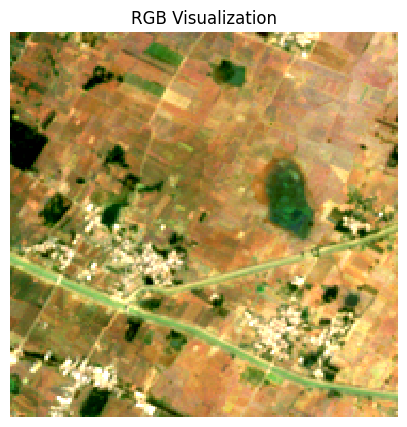

In [ ]:
fig, ax = plt.subplots(1,1)
fig.set_size_inches(5,5)
median_da.sel(band=['red','green','blue']).plot.imshow(
    ax=ax,
    robust=True)
ax.set_title('RGB Visualization')
ax.set_axis_off()
plt.show()

In [ ]:
monthly = ds.groupby('time.month').median(dim='time')
monthly

<xarray.Dataset> Size: 14MB
Dimensions:      (month: 12, y: 202, x: 182)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.584e+05 6.584e+05 ... 6.602e+05 6.602e+05
    spatial_ref  int32 4B 32644
  * month        (month) int64 96B 1 2 3 4 5 6 7 8 9 10 11 12
Data variables:
    red          (month, y, x) float64 4MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    green        (month, y, x) float64 4MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    blue         (month, y, x) float64 4MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>
    nir          (month, y, x) float64 4MB dask.array<chunksize=(1, 202, 182), meta=np.ndarray>

In [ ]:
monthly_da = monthly.to_array('band')

In [ ]:
total_month_composite = monthly_da.sel(month=12)

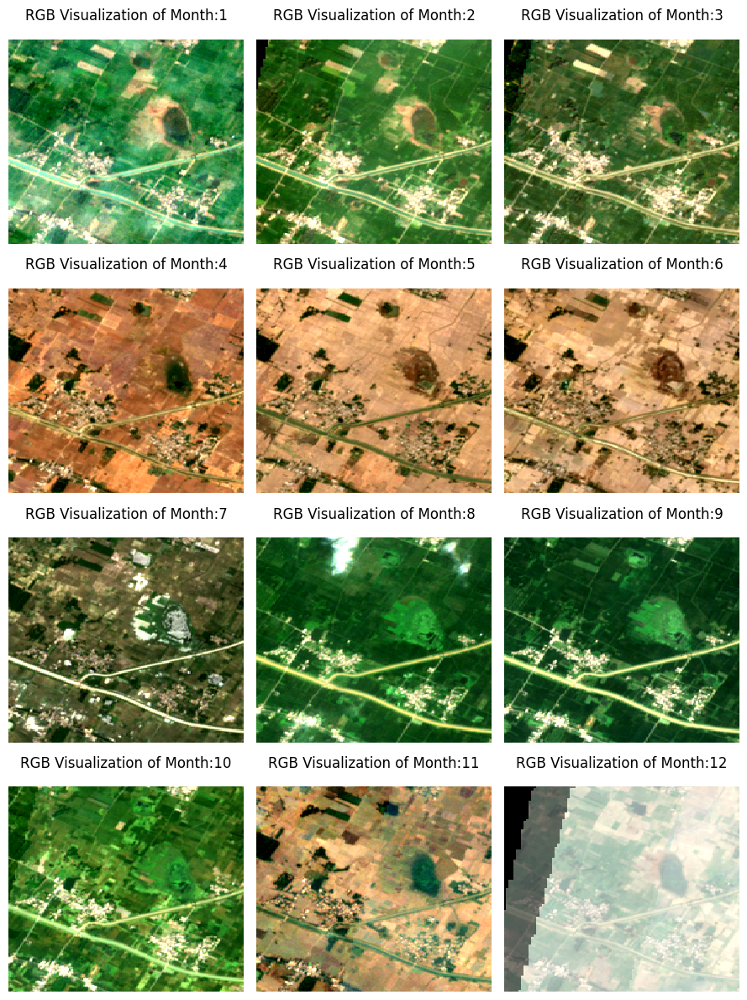

In [ ]:
fig, ax = plt.subplots(4,3)
fig.set_size_inches(9,12)

for index, ax in enumerate(ax.flat):
  monthly_total = monthly_da.isel(month=index)
  monthly_total.sel(band=['red','green','blue']).plot.imshow(
    ax=ax,
    robust=True)
  ax.set_title(f'RGB Visualization of Month:{index+1}')
  ax.set_axis_off()

plt.tight_layout()
plt.show()